<a href="https://colab.research.google.com/github/IkeKobby/image_annotations-labelStudio/blob/main/SimpleTS_flow.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Trying to solve model training issues with simple convolution and con transpose out image size

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# data source 
TARGET_IMAGE_DIR = '/content/drive/MyDrive/segmentation_projects/processed/images'
TARGET_MASK_DIR = '/content/drive/MyDrive/segmentation_projects/processed/labels'
IMAGE_INFO_DIR = '/content/drive/MyDrive/segmentation_projects/processed/mask-label.csv'

In [3]:
# data processing
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import cv2
import os

# handling tensors
import tensorflow as tf

In [4]:
# Data Info
data = pd.read_csv(IMAGE_INFO_DIR)
data.head()

,file_name,file_mask,id,width,height
0,c7289a66-34.png,mask_c7289a66-34.png,0,300,300
1,d28b0caf-33.png,mask_d28b0caf-33.png,1,300,300
2,fb63decd-32.png,mask_fb63decd-32.png,2,300,300
3,c48c0ac3-31.png,mask_c48c0ac3-31.png,3,300,300
4,bd63eba1-30.png,mask_bd63eba1-30.png,4,300,300


In [5]:
# For data preparation, idea is to get image, label in a tuple format, eg, ---> (image, mask).  
# A list of which would contain several images and their respectiv masks(labels--target pixels)
# And for that is there necessary to partion the data into train and val/test.

train_data_info, test_data_info = train_test_split(data, test_size = 0.10, random_state = 1234)
print(f"Train info contains, {train_data_info.shape[0]} images and validation contains, {test_data_info.shape[0]} images.")

Train info contains, 45 images and validation contains, 5 images.


In [6]:
# Make a function for preprocessing images
def preprocess_image(image, label):
  """
  Converts image datatype from 'uint8' -> 'float32'
  """
  image = tf.convert_to_tensor(image, tf.float32)
  mask = tf.convert_to_tensor(label, tf.float32)
  return image/255.0, mask/255.0

In [7]:
# Time to load images and convert to arrays. --> Images must be loaded alongside its mask in a tuple format as described above.
def load_and_convert_to_arrays(image_dir, mask_dir, image_mask_data):
  data = []
  for image, mask in zip(image_mask_data['file_name'], image_mask_data['file_mask']):
    image_path = os.path.join(image_dir, image)
    mask_path = os.path.join(mask_dir, mask)
    image = cv2.imread(image_path)
    mask = cv2.imread(mask_path)
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)
    mask = np.expand_dims(mask, axis=-1)
    image, mask = preprocess_image(image, mask)
    data.append((image, mask))
  return data

In [8]:
#   Apply the function above
train_data = load_and_convert_to_arrays(image_dir = TARGET_IMAGE_DIR, mask_dir=TARGET_MASK_DIR, image_mask_data=train_data_info)

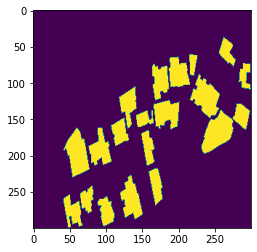

In [9]:
plt.imshow(tf.reshape(train_data[0][1], [300, 300]))

In [10]:
def prepare_for_tf_Dataset(train_inputs):
  input_image_array = []
  input_mask_array = []
  for _, item in enumerate(train_inputs):
    input_image_array.append(item[0])
    input_mask_array.append(item[1])
  return input_image_array, input_mask_array

In [11]:
# put train images in td.data.Dataset format
input_image_array, input_mask_array = prepare_for_tf_Dataset(train_data)
train_DS = tf.data.Dataset.from_tensor_slices((input_image_array, input_mask_array))

In [12]:
# one sample of train image.
one_sample = train_DS.take(1)
one_sample.element_spec

(TensorSpec(shape=(300, 300, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(300, 300, 1), dtype=tf.float32, name=None))

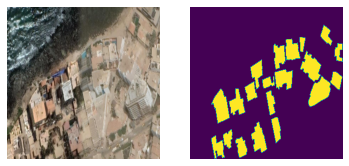

In [13]:
# inspect the data to be sure of the right image-mask pair
for image, mask in one_sample:
  plt.subplot(1, 2, 1)
  plt.axis(False)
  plt.imshow(image)
  plt.subplot(1, 2, 2)
  plt.imshow(tf.reshape(mask, mask.shape[:2]))
  plt.axis(False)

In [14]:
np.unique(mask.numpy())

array([0., 1.], dtype=float32)

In [15]:
# Create test dataset
#   Apply the function above on test data
val_data = load_and_convert_to_arrays(image_dir = TARGET_IMAGE_DIR, mask_dir=TARGET_MASK_DIR, image_mask_data=test_data_info)

# put test images in td.data.Dataset format
input_image_array_val, input_mask_array_val = prepare_for_tf_Dataset(val_data)
val_DS = tf.data.Dataset.from_tensor_slices((input_image_array_val, input_mask_array_val))

In [16]:
# one sample of val image.
_sample = val_DS.take(1)
_sample.element_spec

(TensorSpec(shape=(300, 300, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(300, 300, 1), dtype=tf.float32, name=None))

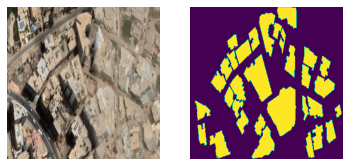

In [17]:
# inspect the data to be sure of the right image-mask pair
for image, mask in _sample:
  plt.subplot(1, 2, 1)
  plt.axis(False)
  plt.imshow(image)
  plt.subplot(1, 2, 2)
  plt.imshow(tf.reshape(mask, mask.shape[:2]))
  plt.axis(False)

In [18]:
# setup the buffer size and batch size for data reading and training
BUFFER_SIZE = 5
BATCH_SIZE = 1

In [19]:
# dataset settings
tf_autotune = tf.data.experimental.AUTOTUNE

# setup the train and test data by shuffling, prefetching, etc
train_dataset = train_DS.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()
train_dataset = train_dataset.prefetch(buffer_size=tf_autotune)
test_dataset  = val_DS.batch(BATCH_SIZE)
train_dataset

<PrefetchDataset element_spec=(TensorSpec(shape=(None, 300, 300, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 300, 300, 1), dtype=tf.float32, name=None))>

In [20]:
# helper function to display an image, it's label and the prediction
def display(display_list, image_size=256):
    plt.figure(figsize=(10, 10))
    title = ['Input Image', 'Label', 'Predicted Label']

    for i in range(len(display_list)):
        if display_list[i].shape[-1] < 3:
          display_resized = tf.reshape(display_list[i], [image_size, image_size])
        else:
          display_resized = display_list[i]
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(display_resized)
        plt.axis('off')
    plt.show()

image has shape; (300, 300, 3) and label has shape: (300, 300, 1)


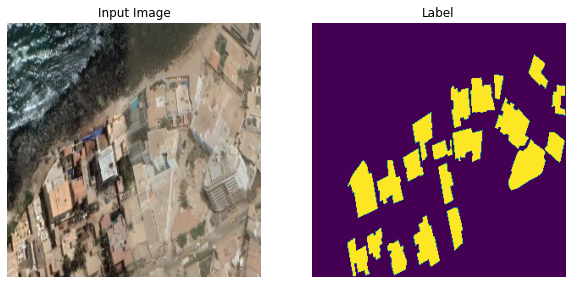

image has shape; (300, 300, 3) and label has shape: (300, 300, 1)


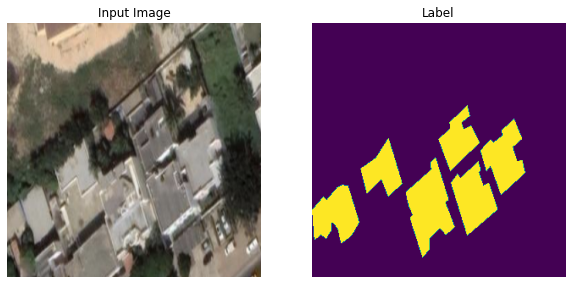

In [21]:
# display an image and label from the training set
for image, label in train_DS.take(2):
    print(f"image has shape; {image.shape} and label has shape: {label.shape}")
    sample_image, sample_label = image, label
    display([sample_image, sample_label], image_size=300)

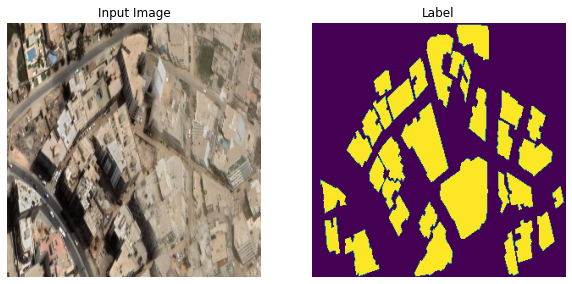

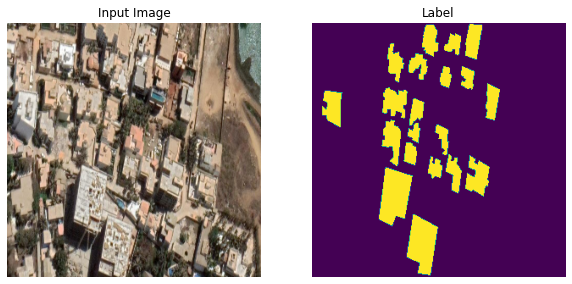

In [22]:
# display an image and label from the test set
for image, label in val_DS.take(2):
    sample_image, sample_label = image, label
    display([sample_image, sample_label], image_size=300)

In [23]:
tf.keras.backend.clear_session()

# set up the model architecture
model = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(input_shape=[300, 300, 3]),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(300*300*2, activation='softmax'),
    tf.keras.layers.Reshape((300, 300, 2))
])

# specify how to train the model with algorithm, the loss function and metrics
model.compile(
    optimizer='adam',
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics=['accuracy'])

In [24]:
# print out the summary of the model
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 270000)            0         
                                                                 
 dense (Dense)               (None, 64)                17280064  
                                                                 
 dense_1 (Dense)             (None, 180000)            11700000  
                                                                 
 reshape (Reshape)           (None, 300, 300, 2)       0         
                                                                 
Total params: 28,980,064
Trainable params: 28,980,064
Non-trainable params: 0
_________________________________________________________________


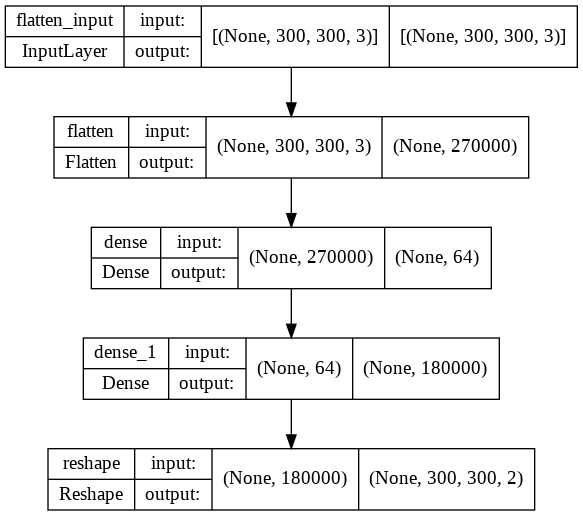

In [25]:
# plot the model including the sizes of the model
tf.keras.utils.plot_model(model, show_shapes=True)

In [26]:
# function to take a prediction from the model and output an image for display
def create_mask(pred_mask):
    pred_mask = tf.argmax(pred_mask, axis=-1)
    pred_mask = pred_mask[..., tf.newaxis]
    return pred_mask[0]

In [28]:
# helper function to show the image, the label and the prediction
def show_predictions(model, img_size =300, dataset=None, num=1):
    if dataset:
        for image, label in dataset.take(num):
            pred_mask = model.predict(image)
            display([image[0], label[0], create_mask(pred_mask)], img_size)
    else:
        prediction = create_mask(model.predict(sample_image[tf.newaxis, ...]))
        display([sample_image, sample_label, prediction], img_size)

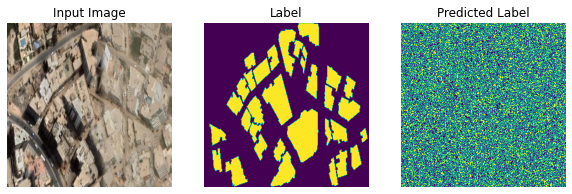

In [29]:
# show a predection, as an example
show_predictions(model = model, dataset = test_dataset)

In [31]:
# define a callback that shows image predictions on the test set
class DisplayCallback(tf.keras.callbacks.Callback):
    def __init__(self, model, image_size):
        self.model = model
        self.image_size = image_size
    def on_epoch_end(self, epoch, logs=None):
        show_predictions(model=self.model, img_size=self.image_size)
        print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

# setup a tensorboard callback
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
displayCallback = DisplayCallback(model=model, image_size=300)

Epoch 1/25
45/45 [==============================] - ETA: 0s - loss: 0.6931 - accuracy: 0.5009

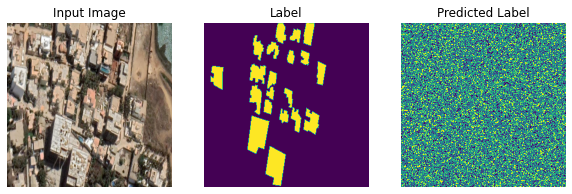


Sample Prediction after epoch 1

45/45 [==============================] - 8s 136ms/step - loss: 0.6931 - accuracy: 0.5009 - val_loss: 0.6931 - val_accuracy: 0.5002
Epoch 2/25
39/45 [=========================>....] - ETA: 0s - loss: 0.6931 - accuracy: 0.5018

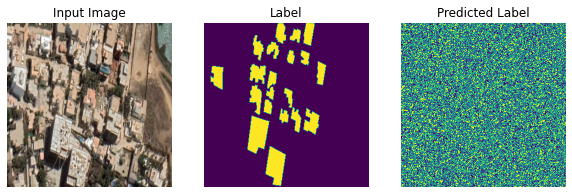


Sample Prediction after epoch 2

45/45 [==============================] - 5s 114ms/step - loss: 0.6931 - accuracy: 0.5019 - val_loss: 0.6931 - val_accuracy: 0.5012
Epoch 3/25
43/45 [===========================>..] - ETA: 0s - loss: 0.6931 - accuracy: 0.5030

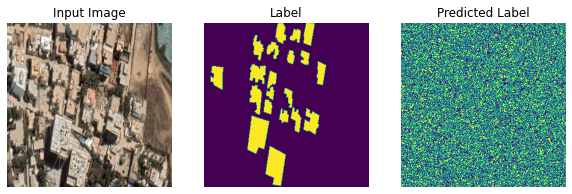


Sample Prediction after epoch 3

45/45 [==============================] - 6s 127ms/step - loss: 0.6931 - accuracy: 0.5032 - val_loss: 0.6931 - val_accuracy: 0.5025
Epoch 4/25
44/45 [============================>.] - ETA: 0s - loss: 0.6931 - accuracy: 0.5044

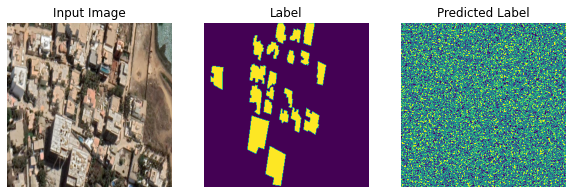


Sample Prediction after epoch 4

45/45 [==============================] - 5s 116ms/step - loss: 0.6931 - accuracy: 0.5044 - val_loss: 0.6931 - val_accuracy: 0.5040
Epoch 5/25
43/45 [===========================>..] - ETA: 0s - loss: 0.6931 - accuracy: 0.5058

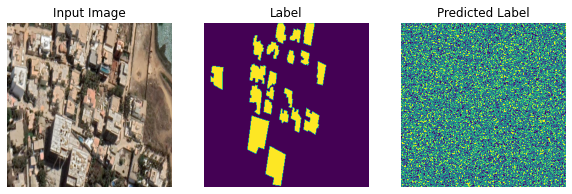


Sample Prediction after epoch 5

45/45 [==============================] - 6s 125ms/step - loss: 0.6931 - accuracy: 0.5059 - val_loss: 0.6931 - val_accuracy: 0.5054
Epoch 6/25
42/45 [===========================>..] - ETA: 0s - loss: 0.6931 - accuracy: 0.5077

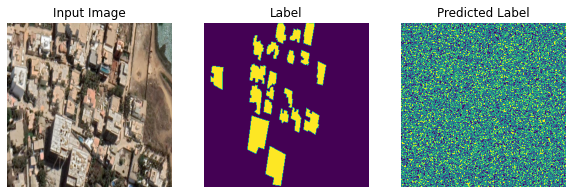


Sample Prediction after epoch 6

45/45 [==============================] - 5s 116ms/step - loss: 0.6931 - accuracy: 0.5079 - val_loss: 0.6931 - val_accuracy: 0.5083
Epoch 7/25
45/45 [==============================] - ETA: 0s - loss: 0.6931 - accuracy: 0.5108

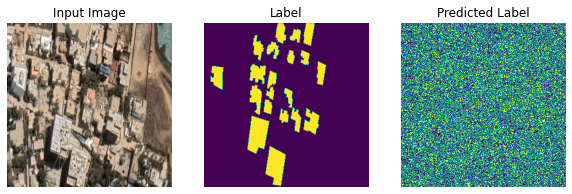


Sample Prediction after epoch 7

45/45 [==============================] - 6s 127ms/step - loss: 0.6931 - accuracy: 0.5108 - val_loss: 0.6931 - val_accuracy: 0.5119
Epoch 8/25
42/45 [===========================>..] - ETA: 0s - loss: 0.6931 - accuracy: 0.5147

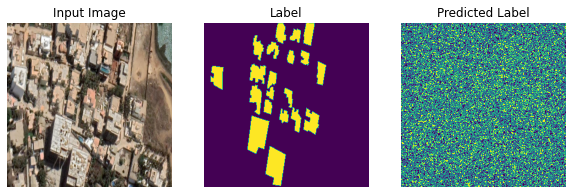


Sample Prediction after epoch 8

45/45 [==============================] - 6s 127ms/step - loss: 0.6931 - accuracy: 0.5151 - val_loss: 0.6931 - val_accuracy: 0.5170
Epoch 9/25
43/45 [===========================>..] - ETA: 0s - loss: 0.6931 - accuracy: 0.5217

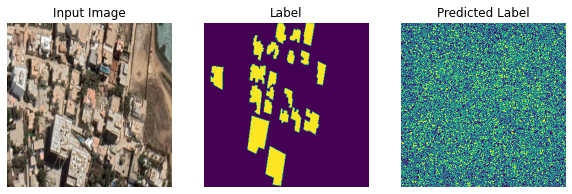


Sample Prediction after epoch 9

45/45 [==============================] - 6s 132ms/step - loss: 0.6931 - accuracy: 0.5216 - val_loss: 0.6931 - val_accuracy: 0.5257
Epoch 10/25
43/45 [===========================>..] - ETA: 0s - loss: 0.6931 - accuracy: 0.5307

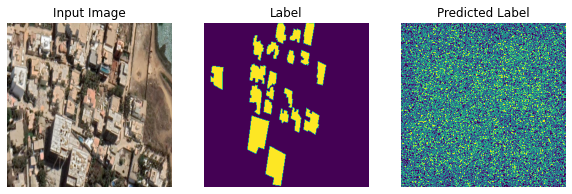


Sample Prediction after epoch 10

45/45 [==============================] - 6s 133ms/step - loss: 0.6931 - accuracy: 0.5315 - val_loss: 0.6931 - val_accuracy: 0.5383
Epoch 11/25
41/45 [==========================>...] - ETA: 0s - loss: 0.6931 - accuracy: 0.5449

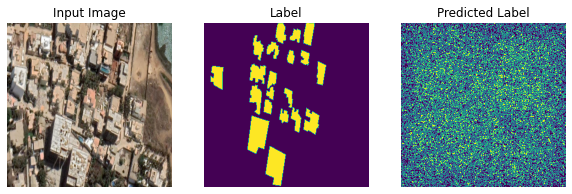


Sample Prediction after epoch 11

45/45 [==============================] - 5s 117ms/step - loss: 0.6931 - accuracy: 0.5462 - val_loss: 0.6931 - val_accuracy: 0.5571
Epoch 12/25
41/45 [==========================>...] - ETA: 0s - loss: 0.6931 - accuracy: 0.5669

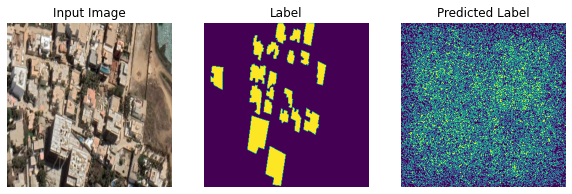


Sample Prediction after epoch 12

45/45 [==============================] - 5s 116ms/step - loss: 0.6931 - accuracy: 0.5678 - val_loss: 0.6931 - val_accuracy: 0.5847
Epoch 13/25
41/45 [==========================>...] - ETA: 0s - loss: 0.6931 - accuracy: 0.5944

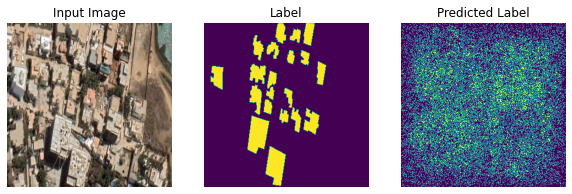


Sample Prediction after epoch 13

45/45 [==============================] - 5s 116ms/step - loss: 0.6931 - accuracy: 0.5963 - val_loss: 0.6931 - val_accuracy: 0.6159
Epoch 14/25
41/45 [==========================>...] - ETA: 0s - loss: 0.6931 - accuracy: 0.6106

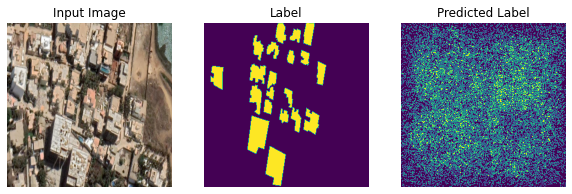


Sample Prediction after epoch 14

45/45 [==============================] - 5s 118ms/step - loss: 0.6931 - accuracy: 0.6133 - val_loss: 0.6931 - val_accuracy: 0.6185
Epoch 15/25
41/45 [==========================>...] - ETA: 0s - loss: 0.6931 - accuracy: 0.6133

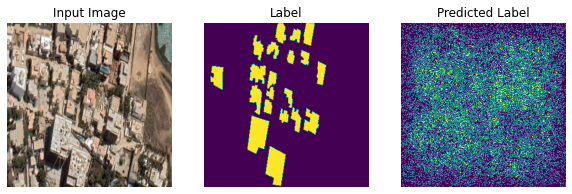


Sample Prediction after epoch 15

45/45 [==============================] - 6s 125ms/step - loss: 0.6931 - accuracy: 0.6138 - val_loss: 0.6931 - val_accuracy: 0.6185
Epoch 16/25
45/45 [==============================] - ETA: 0s - loss: 0.6931 - accuracy: 0.6138

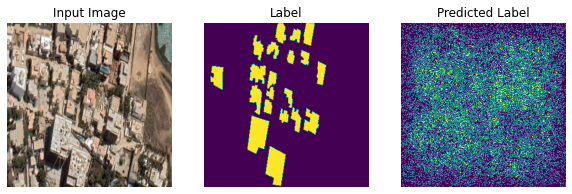


Sample Prediction after epoch 16

45/45 [==============================] - 5s 116ms/step - loss: 0.6931 - accuracy: 0.6138 - val_loss: 0.6931 - val_accuracy: 0.6185
Epoch 17/25
42/45 [===========================>..] - ETA: 0s - loss: 0.6931 - accuracy: 0.6156

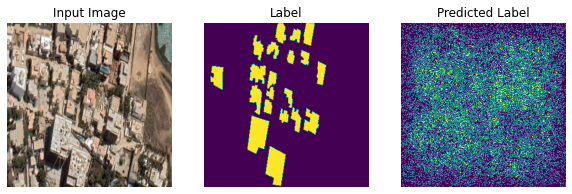


Sample Prediction after epoch 17

45/45 [==============================] - 5s 113ms/step - loss: 0.6931 - accuracy: 0.6138 - val_loss: 0.6931 - val_accuracy: 0.6185
Epoch 18/25
45/45 [==============================] - ETA: 0s - loss: 0.6931 - accuracy: 0.6138

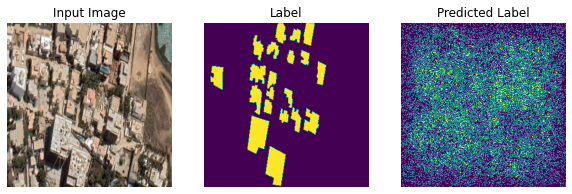


Sample Prediction after epoch 18

45/45 [==============================] - 5s 114ms/step - loss: 0.6931 - accuracy: 0.6138 - val_loss: 0.6931 - val_accuracy: 0.6185
Epoch 19/25
41/45 [==========================>...] - ETA: 0s - loss: 0.6931 - accuracy: 0.6158

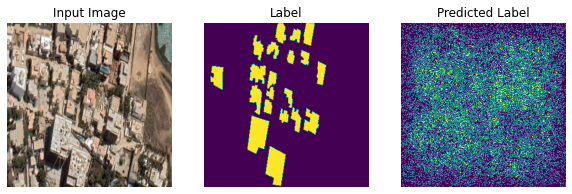


Sample Prediction after epoch 19

45/45 [==============================] - 5s 113ms/step - loss: 0.6931 - accuracy: 0.6138 - val_loss: 0.6931 - val_accuracy: 0.6185
Epoch 20/25
45/45 [==============================] - ETA: 0s - loss: 0.6931 - accuracy: 0.6138

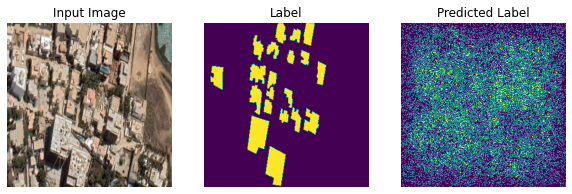


Sample Prediction after epoch 20

45/45 [==============================] - 6s 128ms/step - loss: 0.6931 - accuracy: 0.6138 - val_loss: 0.6931 - val_accuracy: 0.6185
Epoch 21/25
43/45 [===========================>..] - ETA: 0s - loss: 0.6931 - accuracy: 0.6141

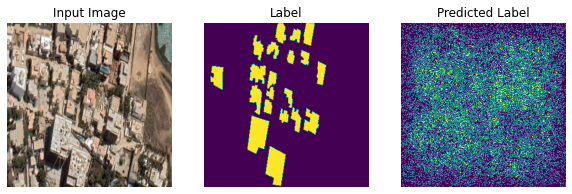


Sample Prediction after epoch 21

45/45 [==============================] - 5s 114ms/step - loss: 0.6931 - accuracy: 0.6138 - val_loss: 0.6931 - val_accuracy: 0.6185
Epoch 22/25
45/45 [==============================] - ETA: 0s - loss: 0.6931 - accuracy: 0.6138

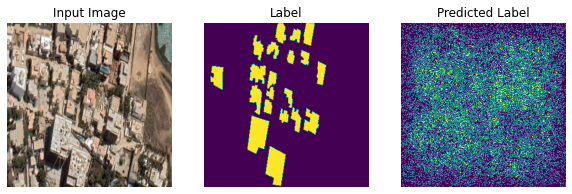


Sample Prediction after epoch 22

45/45 [==============================] - 5s 113ms/step - loss: 0.6931 - accuracy: 0.6138 - val_loss: 0.6931 - val_accuracy: 0.6185
Epoch 23/25
40/45 [=========================>....] - ETA: 0s - loss: 0.6931 - accuracy: 0.6118

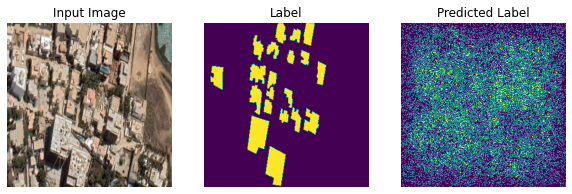


Sample Prediction after epoch 23

45/45 [==============================] - 5s 116ms/step - loss: 0.6931 - accuracy: 0.6138 - val_loss: 0.6931 - val_accuracy: 0.6185
Epoch 24/25
41/45 [==========================>...] - ETA: 0s - loss: 0.6931 - accuracy: 0.6125

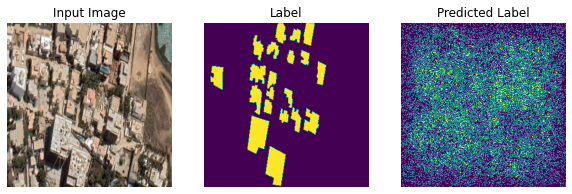


Sample Prediction after epoch 24

45/45 [==============================] - 5s 115ms/step - loss: 0.6931 - accuracy: 0.6138 - val_loss: 0.6931 - val_accuracy: 0.6185
Epoch 25/25
43/45 [===========================>..] - ETA: 0s - loss: 0.6931 - accuracy: 0.6134

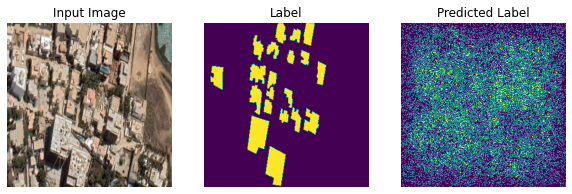


Sample Prediction after epoch 25

45/45 [==============================] - 5s 117ms/step - loss: 0.6931 - accuracy: 0.6138 - val_loss: 0.6931 - val_accuracy: 0.6185


In [33]:
# setup and run the model
EPOCHS = 25
STEPS_PER_EPOCH = len(list(train_DS))
VALIDATION_STEPS = 5

model_history = model.fit(train_dataset, epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_steps=VALIDATION_STEPS,
                          validation_data=test_dataset,
                          callbacks=[displayCallback, tensorboard_callback])

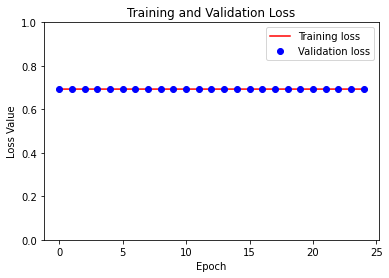

In [34]:
# output model statistics
loss = model_history.history['loss']
val_loss = model_history.history['val_loss']
accuracy = model_history.history['accuracy']
val_accuracy = model_history.history['val_accuracy']

epochs = range(EPOCHS)

plt.figure()
plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'bo', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.ylim([0, 1])
plt.legend()
plt.show()

In [35]:
# evaluate
model.evaluate(test_dataset)

5/5 [==============================] - 0s 4ms/step - loss: 0.6931 - accuracy: 0.6185


[0.6931429505348206, 0.6185466647148132]

In [36]:
# Load extension
%load_ext tensorboard

In [37]:
# Visualize
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

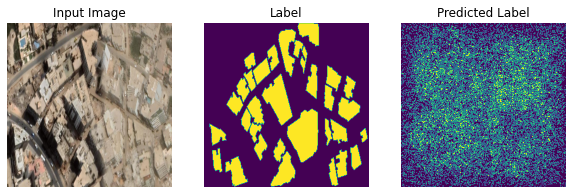

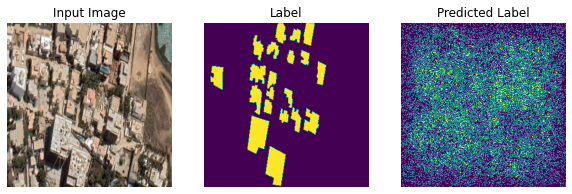

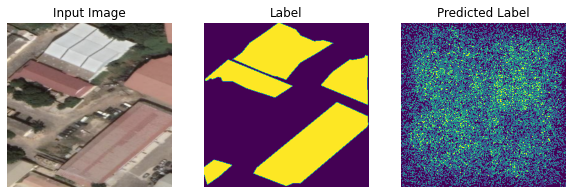

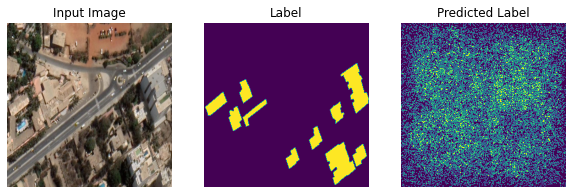

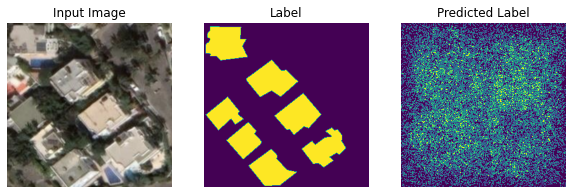

In [38]:
# make some predictions
show_predictions(model = model, 
                 img_size =300, 
                 dataset=test_dataset, 
                 num=5
                 )

In [40]:
# simple cnn layers
tf.keras.backend.clear_session()

layers = [
    tf.keras.layers.Conv2D(input_shape=[256, 256, 3],
           filters=100,
           kernel_size=5,
           strides=2,
           padding="same",
           activation=tf.nn.relu,
           name="Conv1"),
    tf.keras.layers.MaxPool2D(pool_size=2, strides=2, padding="same"),
    tf.keras.layers.Conv2D(filters=200,
           kernel_size=5,
           strides=2,
           padding="same",
           activation=tf.nn.relu),
    tf.keras.layers.MaxPool2D(pool_size=2, strides=2, padding="same"),
    tf.keras.layers.Conv2D(filters=300,
           kernel_size=3,
           strides=1,
           padding="same",
           activation=tf.nn.relu),
    tf.keras.layers.Conv2D(filters=300,
           kernel_size=3,
           strides=1,
           padding="same",
           activation=tf.nn.relu),
    tf.keras.layers.Conv2D(filters=2,
           kernel_size=1,
           strides=1,
           padding="same",
           activation=tf.nn.relu),
    tf.keras.layers.Conv2DTranspose(filters=2, kernel_size=31, strides=16, padding="same"),
]

model_cnn= tf.keras.models.Sequential(layers)

model_cnn.compile(
                optimizer='adam',
                loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
                metrics=['accuracy'])

In [41]:
# print out the summary of the model
model_cnn.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv1 (Conv2D)              (None, 128, 128, 100)     7600      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 100)      0         
 )                                                               
                                                                 
 conv2d (Conv2D)             (None, 32, 32, 200)       500200    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 16, 16, 200)      0         
 2D)                                                             
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 300)       540300    
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 300)       8

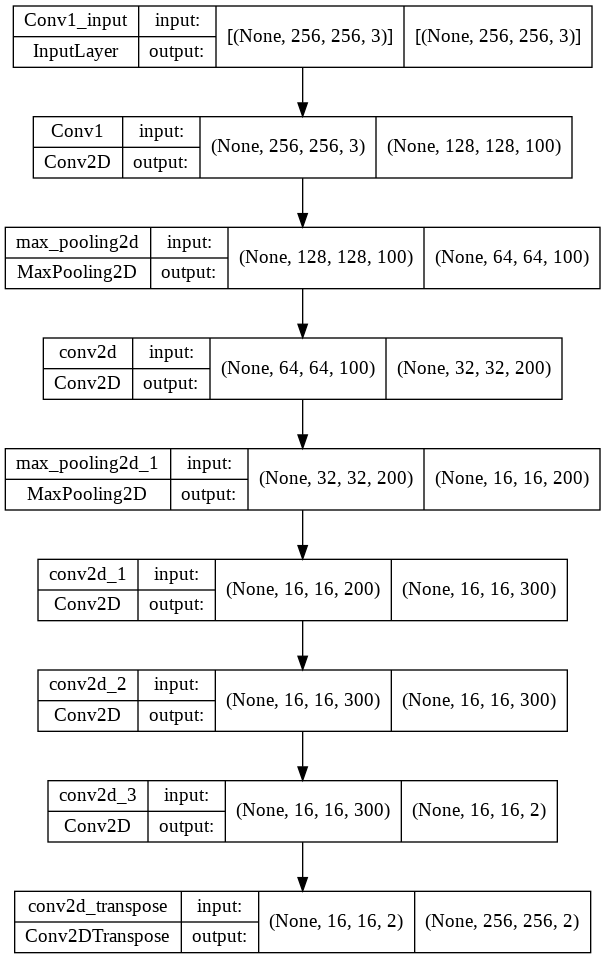

In [42]:
# plot the model including the sizes of the model
tf.keras.utils.plot_model(model, show_shapes=True)

In [43]:
# preprocess data for cnn 32 divisibility.

# Make a function for preprocessing images
def preprocess_image_cnn(image, label, image_size = 256):
  """
  Converts image datatype from 'uint8' -> 'float32'
  """

  image = tf.convert_to_tensor(image, tf.float32)
  mask = tf.convert_to_tensor(label, tf.float32)
  image = tf.image.resize(image,  [image_size, image_size])
  mask = tf.image.resize(mask,  [image_size, image_size])
  return image/255.0, mask/255.0


# Time to load images and convert to arrays. --> Images must be loaded alongside its mask in a tuple format as described above.
def load_and_convert_to_arrays_cnn(image_dir, mask_dir, image_mask_data):
  data = []
  for image, mask in zip(image_mask_data['file_name'], image_mask_data['file_mask']):
    image_path = os.path.join(image_dir, image)
    mask_path = os.path.join(mask_dir, mask)
    image = cv2.imread(image_path)
    mask = cv2.imread(mask_path)
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)
    mask = np.expand_dims(mask, axis=-1)
    image, mask = preprocess_image_cnn(image, mask)
    data.append((image, mask))
  return data


#   Apply the function above
train_data_cnn = load_and_convert_to_arrays_cnn(image_dir = TARGET_IMAGE_DIR, mask_dir=TARGET_MASK_DIR, image_mask_data=train_data_info)
val_data_cnn = load_and_convert_to_arrays_cnn(image_dir = TARGET_IMAGE_DIR, mask_dir=TARGET_MASK_DIR, image_mask_data=test_data_info)


# prepare data for loading
def prepare_for_tf_Dataset_cnn(train_inputs):
  input_image_array = []
  input_mask_array = []
  for _, item in enumerate(train_inputs):
    input_image_array.append(item[0])
    input_mask_array.append(item[1])
  return input_image_array, input_mask_array

# put train images in td.data.Dataset format
input_image_array_cnn, input_mask_array_cnn = prepare_for_tf_Dataset_cnn(train_data_cnn)
train_DS_cnn = tf.data.Dataset.from_tensor_slices((input_image_array_cnn, input_mask_array_cnn))

# validation
input_image_array_val_cnn, input_mask_array_val_cnn = prepare_for_tf_Dataset_cnn(val_data_cnn)
val_DS_cnn = tf.data.Dataset.from_tensor_slices((input_image_array_val_cnn, input_mask_array_val_cnn))



# setup the train and test data by shuffling, prefetching, etc
train_dataset_cnn = train_DS_cnn.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()
train_dataset_cnn = train_dataset_cnn.prefetch(buffer_size=tf_autotune)
test_dataset_cnn  = val_DS_cnn.batch(BATCH_SIZE)
train_dataset_cnn

<PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None))>

In [54]:
for image, label in test_dataset_cnn.take(45):
  print(label.shape)

(1, 256, 256, 1)
(1, 256, 256, 1)
(1, 256, 256, 1)
(1, 256, 256, 1)
(1, 256, 256, 1)


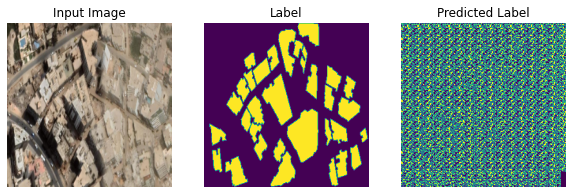

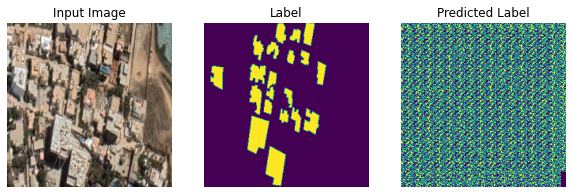

In [55]:
# make some predictions
show_predictions(model = model_cnn, 
                 img_size =256, 
                 dataset=test_dataset_cnn, 
                 num=2
                 )

In [64]:
# Initialize new directories for new task
logdir_cnn = os.path.join("logs_cnn", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback_cnn = tf.keras.callbacks.TensorBoard(logdir_cnn, histogram_freq=1)
displayCallback_cnn = DisplayCallback(model=model_cnn, image_size=256)

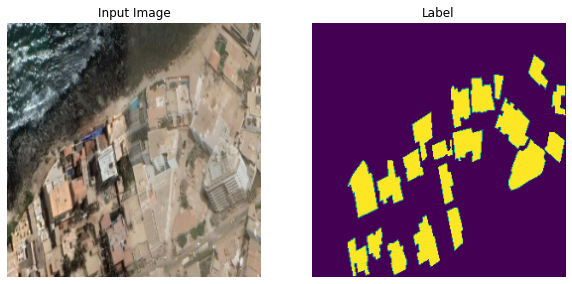

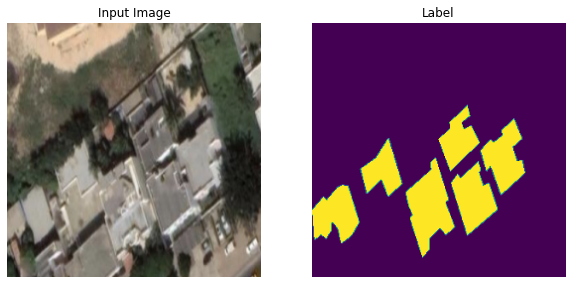

In [65]:
for image, label in train_DS_cnn.take(2):
  sample_image, sample_label = image, label
  display([sample_image, sample_label], image_size=256)

Epoch 1/30
41/45 [==========================>...] - ETA: 0s - loss: 0.5521 - accuracy: 0.6843

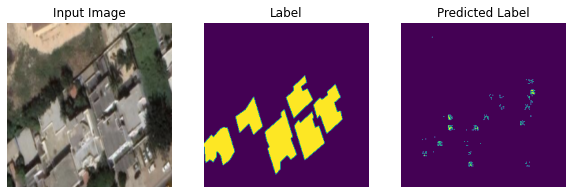


Sample Prediction after epoch 1

45/45 [==============================] - 2s 44ms/step - loss: 0.5436 - accuracy: 0.6915 - val_loss: 0.4399 - val_accuracy: 0.7566
Epoch 2/30
44/45 [============================>.] - ETA: 0s - loss: 0.5177 - accuracy: 0.6916

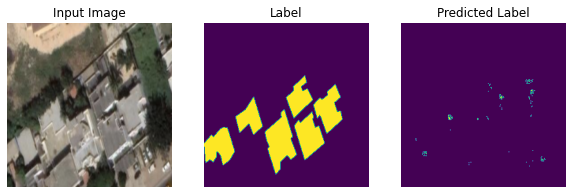


Sample Prediction after epoch 2

45/45 [==============================] - 2s 36ms/step - loss: 0.5155 - accuracy: 0.6924 - val_loss: 0.4753 - val_accuracy: 0.7561
Epoch 3/30
43/45 [===========================>..] - ETA: 0s - loss: 0.5384 - accuracy: 0.6851

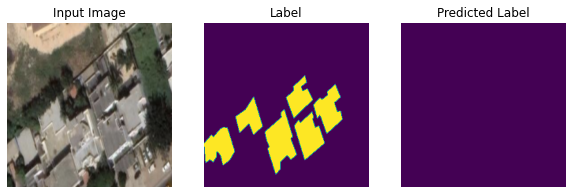


Sample Prediction after epoch 3

45/45 [==============================] - 1s 29ms/step - loss: 0.5322 - accuracy: 0.6916 - val_loss: 0.5644 - val_accuracy: 0.7557
Epoch 4/30
41/45 [==========================>...] - ETA: 0s - loss: 0.5198 - accuracy: 0.6900

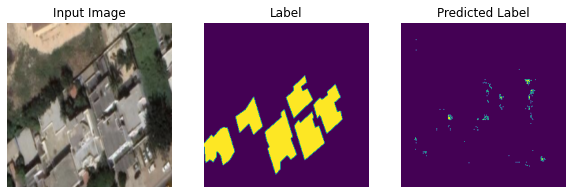


Sample Prediction after epoch 4

45/45 [==============================] - 1s 26ms/step - loss: 0.5198 - accuracy: 0.6921 - val_loss: 0.4578 - val_accuracy: 0.7560
Epoch 5/30
38/45 [========================>.....] - ETA: 0s - loss: 0.5092 - accuracy: 0.6944

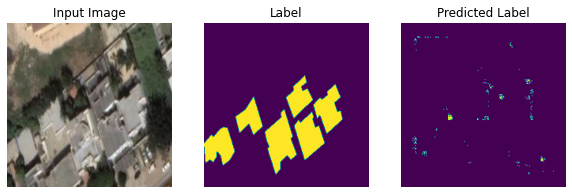


Sample Prediction after epoch 5

45/45 [==============================] - 60s 1s/step - loss: 0.5085 - accuracy: 0.6925 - val_loss: 0.4508 - val_accuracy: 0.7571
Epoch 6/30
42/45 [===========================>..] - ETA: 0s - loss: 0.4956 - accuracy: 0.6929

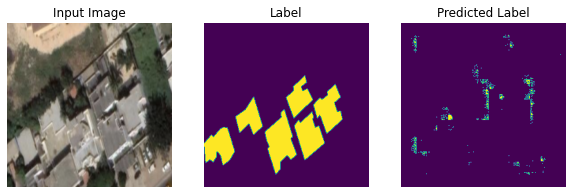


Sample Prediction after epoch 6

45/45 [==============================] - 1s 27ms/step - loss: 0.4924 - accuracy: 0.6941 - val_loss: 0.4478 - val_accuracy: 0.7566
Epoch 7/30
45/45 [==============================] - ETA: 0s - loss: 0.4772 - accuracy: 0.6999

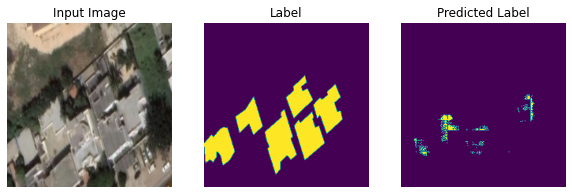


Sample Prediction after epoch 7

45/45 [==============================] - 1s 24ms/step - loss: 0.4772 - accuracy: 0.6999 - val_loss: 0.4240 - val_accuracy: 0.7660
Epoch 8/30
44/45 [============================>.] - ETA: 0s - loss: 0.5009 - accuracy: 0.6954

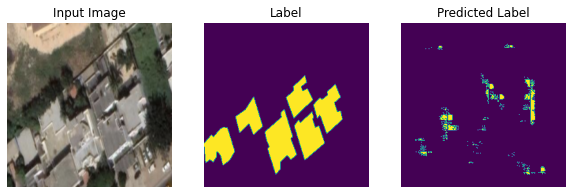


Sample Prediction after epoch 8

45/45 [==============================] - 1s 23ms/step - loss: 0.4988 - accuracy: 0.6986 - val_loss: 0.4164 - val_accuracy: 0.7632
Epoch 9/30
38/45 [========================>.....] - ETA: 0s - loss: 0.5214 - accuracy: 0.6913

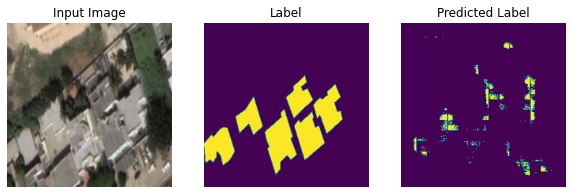


Sample Prediction after epoch 9

45/45 [==============================] - 2s 38ms/step - loss: 0.5100 - accuracy: 0.6995 - val_loss: 0.4112 - val_accuracy: 0.7632
Epoch 10/30
43/45 [===========================>..] - ETA: 0s - loss: 0.4876 - accuracy: 0.7047

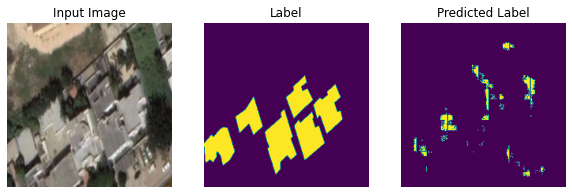


Sample Prediction after epoch 10

45/45 [==============================] - 1s 24ms/step - loss: 0.4870 - accuracy: 0.7041 - val_loss: 0.4114 - val_accuracy: 0.7627
Epoch 11/30
43/45 [===========================>..] - ETA: 0s - loss: 0.4720 - accuracy: 0.7041

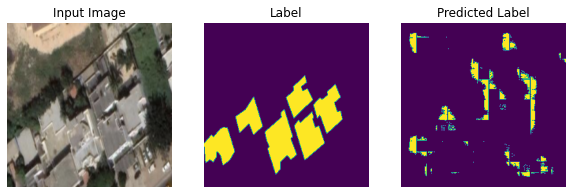


Sample Prediction after epoch 11

45/45 [==============================] - 1s 25ms/step - loss: 0.4705 - accuracy: 0.7088 - val_loss: 0.4585 - val_accuracy: 0.7550
Epoch 12/30
43/45 [===========================>..] - ETA: 0s - loss: 0.4738 - accuracy: 0.7105

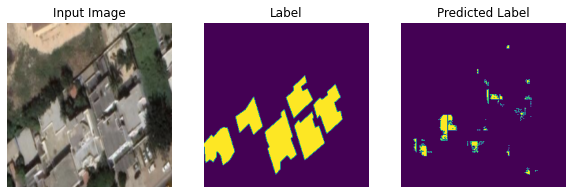


Sample Prediction after epoch 12

45/45 [==============================] - 1s 24ms/step - loss: 0.4701 - accuracy: 0.7145 - val_loss: 0.4251 - val_accuracy: 0.7673
Epoch 13/30
43/45 [===========================>..] - ETA: 0s - loss: 0.4728 - accuracy: 0.7155

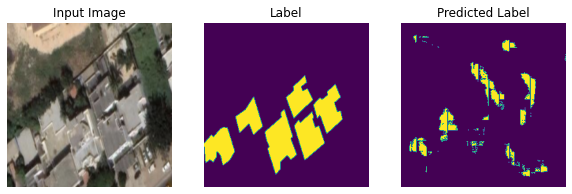


Sample Prediction after epoch 13

45/45 [==============================] - 1s 24ms/step - loss: 0.4712 - accuracy: 0.7164 - val_loss: 0.4057 - val_accuracy: 0.7635
Epoch 14/30
42/45 [===========================>..] - ETA: 0s - loss: 0.4518 - accuracy: 0.7230

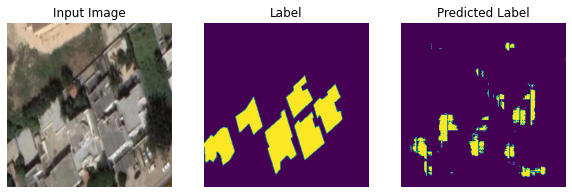


Sample Prediction after epoch 14

45/45 [==============================] - 1s 27ms/step - loss: 0.4474 - accuracy: 0.7278 - val_loss: 0.3957 - val_accuracy: 0.7734
Epoch 15/30
41/45 [==========================>...] - ETA: 0s - loss: 0.4879 - accuracy: 0.7116

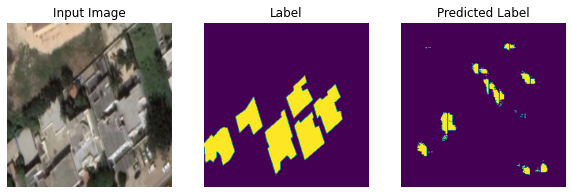


Sample Prediction after epoch 15

45/45 [==============================] - 1s 27ms/step - loss: 0.4785 - accuracy: 0.7186 - val_loss: 0.4570 - val_accuracy: 0.7621
Epoch 16/30
44/45 [============================>.] - ETA: 0s - loss: 0.4530 - accuracy: 0.7282

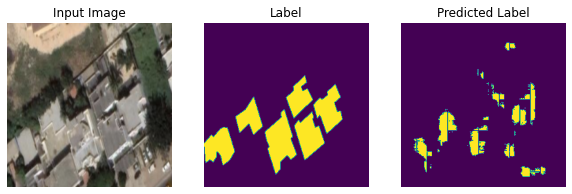


Sample Prediction after epoch 16

45/45 [==============================] - 1s 27ms/step - loss: 0.4521 - accuracy: 0.7284 - val_loss: 0.3944 - val_accuracy: 0.7774
Epoch 17/30
43/45 [===========================>..] - ETA: 0s - loss: 0.4364 - accuracy: 0.7389

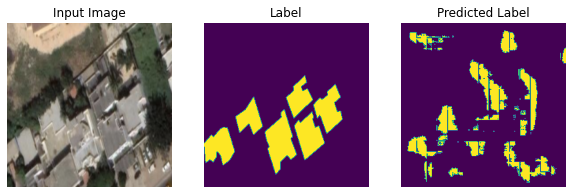


Sample Prediction after epoch 17

45/45 [==============================] - 1s 26ms/step - loss: 0.4366 - accuracy: 0.7394 - val_loss: 0.4259 - val_accuracy: 0.7602
Epoch 18/30
42/45 [===========================>..] - ETA: 0s - loss: 0.4387 - accuracy: 0.7411

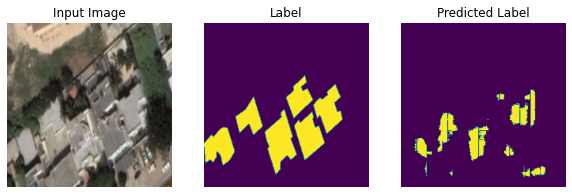


Sample Prediction after epoch 18

45/45 [==============================] - 1s 28ms/step - loss: 0.4352 - accuracy: 0.7440 - val_loss: 0.3887 - val_accuracy: 0.7862
Epoch 19/30
45/45 [==============================] - ETA: 0s - loss: 0.4190 - accuracy: 0.7566

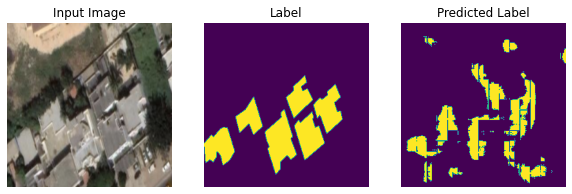


Sample Prediction after epoch 19

45/45 [==============================] - 1s 28ms/step - loss: 0.4190 - accuracy: 0.7566 - val_loss: 0.3927 - val_accuracy: 0.7799
Epoch 20/30
45/45 [==============================] - ETA: 0s - loss: 0.4164 - accuracy: 0.7661

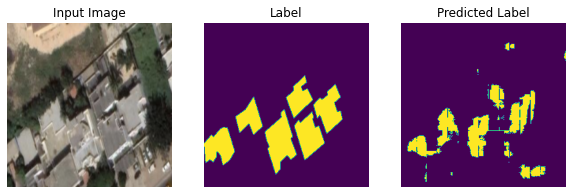


Sample Prediction after epoch 20

45/45 [==============================] - 2s 35ms/step - loss: 0.4164 - accuracy: 0.7661 - val_loss: 0.3832 - val_accuracy: 0.7954
Epoch 21/30
41/45 [==========================>...] - ETA: 0s - loss: 0.4172 - accuracy: 0.7670

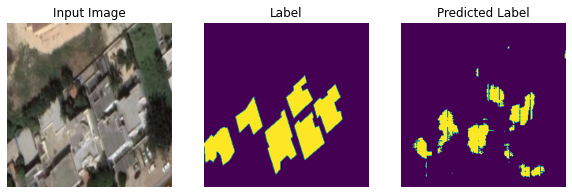


Sample Prediction after epoch 21

45/45 [==============================] - 1s 29ms/step - loss: 0.4151 - accuracy: 0.7689 - val_loss: 0.3802 - val_accuracy: 0.7944
Epoch 22/30
42/45 [===========================>..] - ETA: 0s - loss: 0.4147 - accuracy: 0.7746

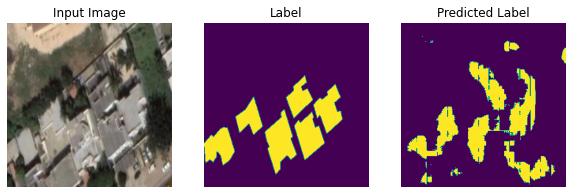


Sample Prediction after epoch 22

45/45 [==============================] - 1s 22ms/step - loss: 0.4103 - accuracy: 0.7772 - val_loss: 0.3974 - val_accuracy: 0.7845
Epoch 23/30
42/45 [===========================>..] - ETA: 0s - loss: 0.3975 - accuracy: 0.7851

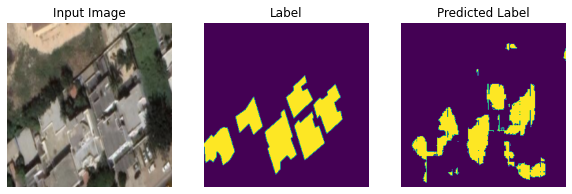


Sample Prediction after epoch 23

45/45 [==============================] - 1s 22ms/step - loss: 0.3910 - accuracy: 0.7885 - val_loss: 0.3793 - val_accuracy: 0.8026
Epoch 24/30
44/45 [============================>.] - ETA: 0s - loss: 0.3973 - accuracy: 0.7887

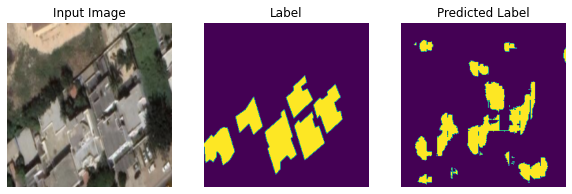


Sample Prediction after epoch 24

45/45 [==============================] - 1s 22ms/step - loss: 0.3968 - accuracy: 0.7891 - val_loss: 0.4017 - val_accuracy: 0.7768
Epoch 25/30
43/45 [===========================>..] - ETA: 0s - loss: 0.3843 - accuracy: 0.7949

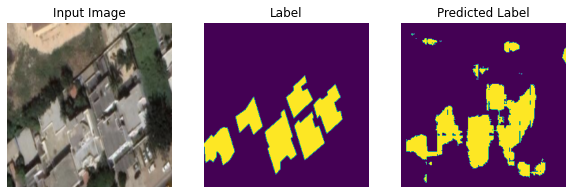


Sample Prediction after epoch 25

45/45 [==============================] - 1s 22ms/step - loss: 0.3819 - accuracy: 0.7965 - val_loss: 0.3986 - val_accuracy: 0.7836
Epoch 26/30
44/45 [============================>.] - ETA: 0s - loss: 0.3683 - accuracy: 0.8091

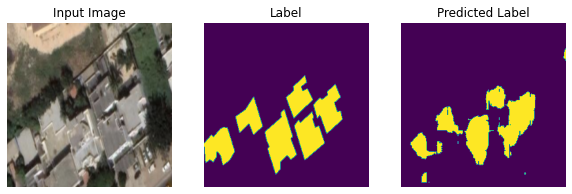


Sample Prediction after epoch 26

45/45 [==============================] - 1s 22ms/step - loss: 0.3666 - accuracy: 0.8098 - val_loss: 0.3815 - val_accuracy: 0.8049
Epoch 27/30
40/45 [=========================>....] - ETA: 0s - loss: 0.3654 - accuracy: 0.8095

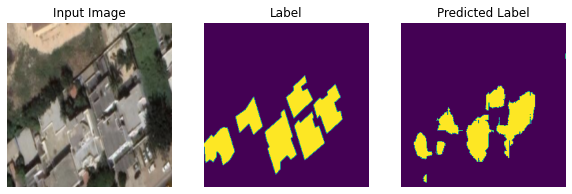


Sample Prediction after epoch 27

45/45 [==============================] - 1s 22ms/step - loss: 0.3557 - accuracy: 0.8149 - val_loss: 0.4005 - val_accuracy: 0.8097
Epoch 28/30
45/45 [==============================] - ETA: 0s - loss: 0.3364 - accuracy: 0.8261

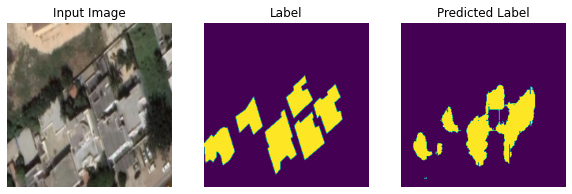


Sample Prediction after epoch 28

45/45 [==============================] - 1s 23ms/step - loss: 0.3364 - accuracy: 0.8261 - val_loss: 0.3932 - val_accuracy: 0.7978
Epoch 29/30
42/45 [===========================>..] - ETA: 0s - loss: 0.3332 - accuracy: 0.8272

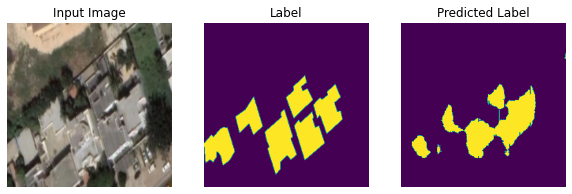


Sample Prediction after epoch 29

45/45 [==============================] - 1s 22ms/step - loss: 0.3273 - accuracy: 0.8306 - val_loss: 0.3957 - val_accuracy: 0.8138
Epoch 30/30
42/45 [===========================>..] - ETA: 0s - loss: 0.3068 - accuracy: 0.8395

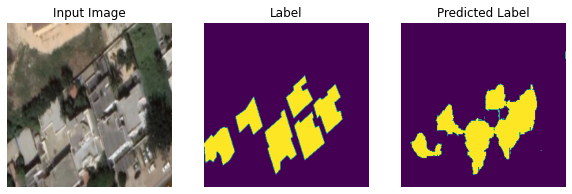


Sample Prediction after epoch 30

45/45 [==============================] - 1s 22ms/step - loss: 0.3070 - accuracy: 0.8391 - val_loss: 0.3693 - val_accuracy: 0.8122


In [67]:
# setup and run the model
EPOCHS = 30
STEPS_PER_EPOCH = 45
VALIDATION_STEPS = 5

model_history_cnn = model_cnn.fit(train_dataset_cnn, 
                              epochs=EPOCHS,
                              steps_per_epoch=STEPS_PER_EPOCH,
                              validation_steps=VALIDATION_STEPS,
                              validation_data=test_dataset_cnn,
                              callbacks=[displayCallback_cnn, tensorboard_callback_cnn])

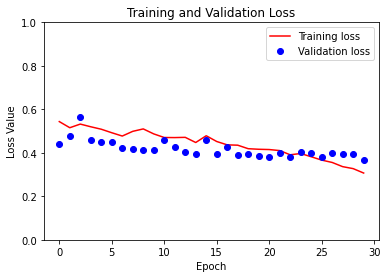

In [68]:
# output model statistics
loss = model_history_cnn.history['loss']
val_loss = model_history_cnn.history['val_loss']
accuracy = model_history_cnn.history['accuracy']
val_accuracy = model_history_cnn.history['val_accuracy']

epochs = range(EPOCHS)

plt.figure()
plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'bo', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.ylim([0, 1])
plt.legend()
plt.show()

In [69]:
# Evaluate
model_cnn.evaluate(test_dataset_cnn)

5/5 [==============================] - 0s 7ms/step - loss: 0.3693 - accuracy: 0.8122


[0.36927318572998047, 0.8121734857559204]

In [70]:
# Load extension
%load_ext tensorboard

# Visualize
%tensorboard --logdir logs_cnn

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

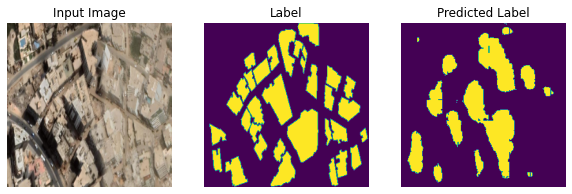

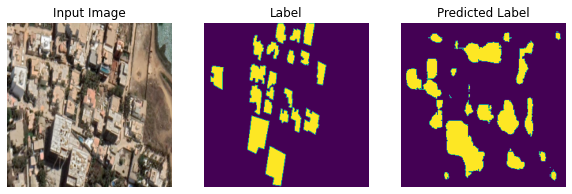

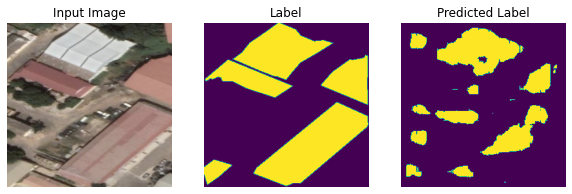

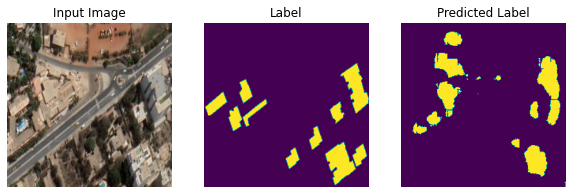

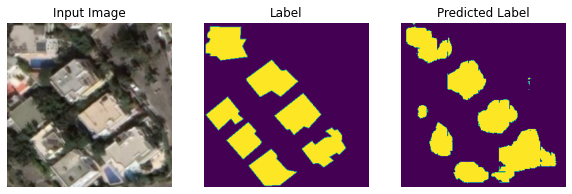

In [71]:
# make some predictions
show_predictions(model = model_cnn, 
                 img_size =256, 
                 dataset=test_dataset_cnn, 
                 num=5
                 )

## With dice score 

In [73]:
from tensorflow.keras import backend as K
def dice_coef(y_true, y_pred, smooth=1):
    indices = K.argmax(y_pred, 3)
    indices = K.reshape(indices, [-1, 256, 256, 1])

    true_cast = y_true
    indices_cast = K.cast(indices, dtype='float32')

    axis = [1, 2, 3]
    intersection = K.sum(true_cast * indices_cast, axis=axis)
    union = K.sum(true_cast, axis=axis) + K.sum(indices_cast, axis=axis)
    dice = K.mean((2. * intersection + smooth)/(union + smooth), axis=0)

    return dice

In [74]:
tf.keras.backend.clear_session() 
model_cnn_dice = tf.keras.models.Sequential(layers)

model_cnn_dice.compile(
                optimizer='adam',
                loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
                metrics=[dice_coef, 'accuracy'])

Epoch 1/45
42/45 [===========================>..] - ETA: 0s - loss: 0.1365 - dice_coef: 0.8762 - accuracy: 0.9210

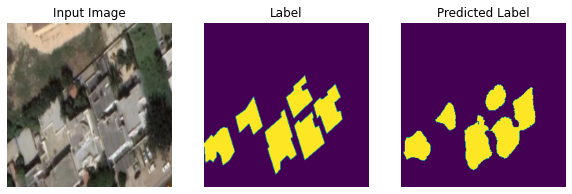


Sample Prediction after epoch 1

45/45 [==============================] - 2s 37ms/step - loss: 0.1360 - dice_coef: 0.8745 - accuracy: 0.9211 - val_loss: 0.5092 - val_dice_coef: 0.5365 - val_accuracy: 0.8199
Epoch 2/45
39/45 [=========================>....] - ETA: 0s - loss: 0.1318 - dice_coef: 0.8705 - accuracy: 0.9224

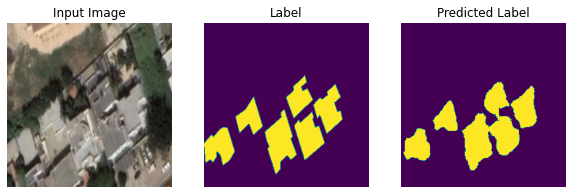


Sample Prediction after epoch 2

45/45 [==============================] - 2s 35ms/step - loss: 0.1314 - dice_coef: 0.8703 - accuracy: 0.9218 - val_loss: 0.4711 - val_dice_coef: 0.5665 - val_accuracy: 0.8164
Epoch 3/45
40/45 [=========================>....] - ETA: 0s - loss: 0.1264 - dice_coef: 0.8829 - accuracy: 0.9238

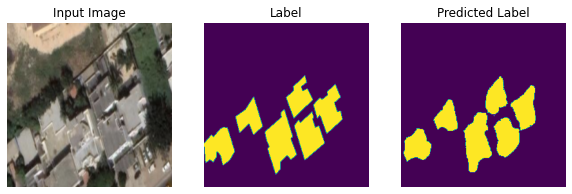


Sample Prediction after epoch 3

45/45 [==============================] - 1s 28ms/step - loss: 0.1231 - dice_coef: 0.8825 - accuracy: 0.9254 - val_loss: 0.5073 - val_dice_coef: 0.5429 - val_accuracy: 0.8170
Epoch 4/45
39/45 [=========================>....] - ETA: 0s - loss: 0.1317 - dice_coef: 0.8752 - accuracy: 0.9215

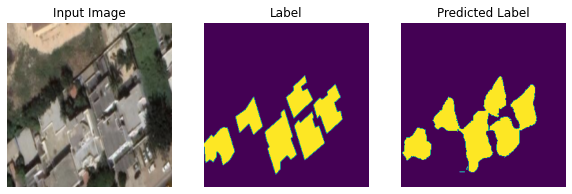


Sample Prediction after epoch 4

45/45 [==============================] - 1s 26ms/step - loss: 0.1271 - dice_coef: 0.8769 - accuracy: 0.9238 - val_loss: 0.4934 - val_dice_coef: 0.5673 - val_accuracy: 0.8166
Epoch 5/45
43/45 [===========================>..] - ETA: 0s - loss: 0.1214 - dice_coef: 0.8875 - accuracy: 0.9264

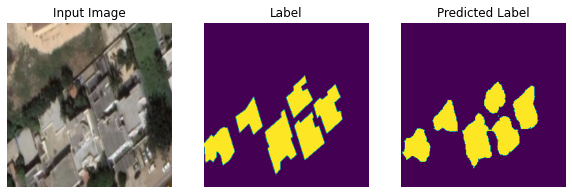


Sample Prediction after epoch 5

45/45 [==============================] - 1s 26ms/step - loss: 0.1212 - dice_coef: 0.8831 - accuracy: 0.9262 - val_loss: 0.5080 - val_dice_coef: 0.5610 - val_accuracy: 0.8161
Epoch 6/45
44/45 [============================>.] - ETA: 0s - loss: 0.1180 - dice_coef: 0.8886 - accuracy: 0.9280

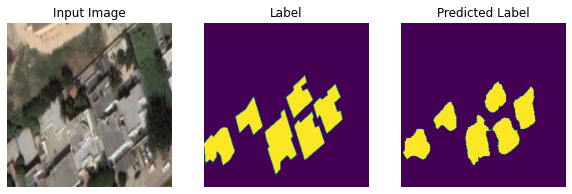


Sample Prediction after epoch 6

45/45 [==============================] - 1s 28ms/step - loss: 0.1177 - dice_coef: 0.8878 - accuracy: 0.9280 - val_loss: 0.5701 - val_dice_coef: 0.5278 - val_accuracy: 0.8180
Epoch 7/45
41/45 [==========================>...] - ETA: 0s - loss: 0.1179 - dice_coef: 0.8819 - accuracy: 0.9276

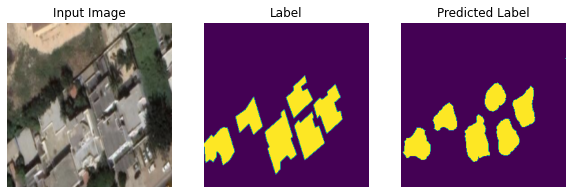


Sample Prediction after epoch 7

45/45 [==============================] - 1s 23ms/step - loss: 0.1182 - dice_coef: 0.8827 - accuracy: 0.9274 - val_loss: 0.5786 - val_dice_coef: 0.5419 - val_accuracy: 0.8148
Epoch 8/45
43/45 [===========================>..] - ETA: 0s - loss: 0.1344 - dice_coef: 0.8762 - accuracy: 0.9206

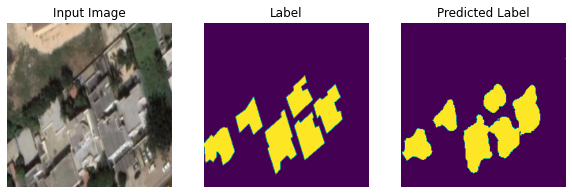


Sample Prediction after epoch 8

45/45 [==============================] - 1s 22ms/step - loss: 0.1323 - dice_coef: 0.8776 - accuracy: 0.9218 - val_loss: 0.5125 - val_dice_coef: 0.5732 - val_accuracy: 0.8114
Epoch 9/45
42/45 [===========================>..] - ETA: 0s - loss: 0.1404 - dice_coef: 0.8626 - accuracy: 0.9184

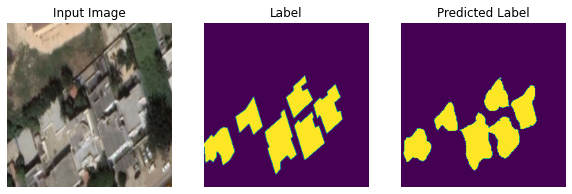


Sample Prediction after epoch 9

45/45 [==============================] - 1s 23ms/step - loss: 0.1387 - dice_coef: 0.8629 - accuracy: 0.9188 - val_loss: 0.5375 - val_dice_coef: 0.5346 - val_accuracy: 0.8045
Epoch 10/45
43/45 [===========================>..] - ETA: 0s - loss: 0.1250 - dice_coef: 0.8830 - accuracy: 0.9248

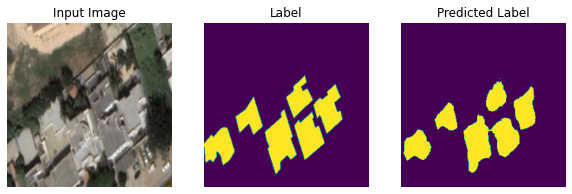


Sample Prediction after epoch 10

45/45 [==============================] - 1s 22ms/step - loss: 0.1219 - dice_coef: 0.8839 - accuracy: 0.9266 - val_loss: 0.5519 - val_dice_coef: 0.5377 - val_accuracy: 0.8168
Epoch 11/45
42/45 [===========================>..] - ETA: 0s - loss: 0.1181 - dice_coef: 0.8855 - accuracy: 0.9272

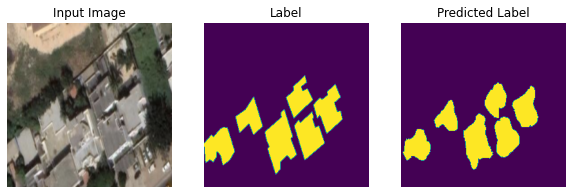


Sample Prediction after epoch 11

45/45 [==============================] - 1s 23ms/step - loss: 0.1158 - dice_coef: 0.8883 - accuracy: 0.9284 - val_loss: 0.5264 - val_dice_coef: 0.5709 - val_accuracy: 0.8086
Epoch 12/45
41/45 [==========================>...] - ETA: 0s - loss: 0.1183 - dice_coef: 0.8890 - accuracy: 0.9275

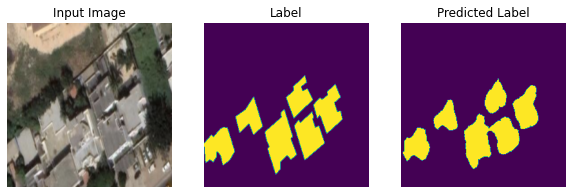


Sample Prediction after epoch 12

45/45 [==============================] - 1s 23ms/step - loss: 0.1162 - dice_coef: 0.8871 - accuracy: 0.9283 - val_loss: 0.5546 - val_dice_coef: 0.5349 - val_accuracy: 0.8129
Epoch 13/45
43/45 [===========================>..] - ETA: 0s - loss: 0.1117 - dice_coef: 0.8907 - accuracy: 0.9299

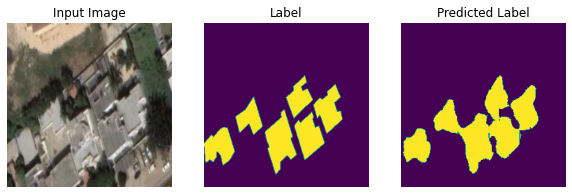


Sample Prediction after epoch 13

45/45 [==============================] - 1s 22ms/step - loss: 0.1122 - dice_coef: 0.8904 - accuracy: 0.9296 - val_loss: 0.5266 - val_dice_coef: 0.5543 - val_accuracy: 0.8063
Epoch 14/45
41/45 [==========================>...] - ETA: 0s - loss: 0.1118 - dice_coef: 0.8904 - accuracy: 0.9307

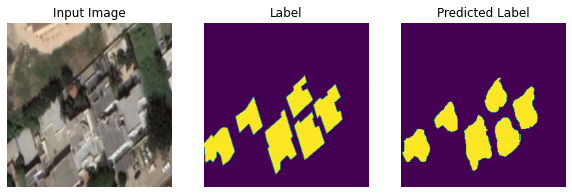


Sample Prediction after epoch 14

45/45 [==============================] - 1s 23ms/step - loss: 0.1129 - dice_coef: 0.8911 - accuracy: 0.9297 - val_loss: 0.5484 - val_dice_coef: 0.5538 - val_accuracy: 0.8130
Epoch 15/45
41/45 [==========================>...] - ETA: 0s - loss: 0.1132 - dice_coef: 0.8907 - accuracy: 0.9291

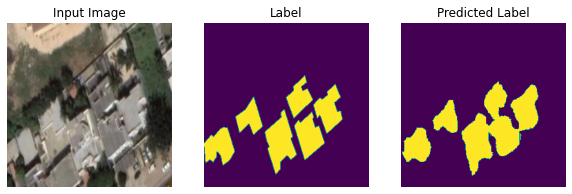


Sample Prediction after epoch 15

45/45 [==============================] - 1s 23ms/step - loss: 0.1132 - dice_coef: 0.8893 - accuracy: 0.9292 - val_loss: 0.5065 - val_dice_coef: 0.5809 - val_accuracy: 0.8081
Epoch 16/45
41/45 [==========================>...] - ETA: 0s - loss: 0.1160 - dice_coef: 0.8914 - accuracy: 0.9283

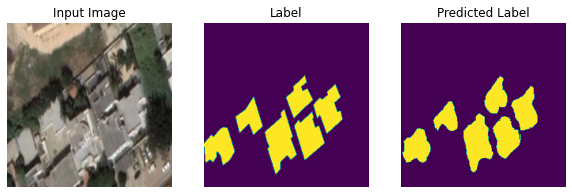


Sample Prediction after epoch 16

45/45 [==============================] - 1s 22ms/step - loss: 0.1141 - dice_coef: 0.8906 - accuracy: 0.9292 - val_loss: 0.5480 - val_dice_coef: 0.5711 - val_accuracy: 0.8111
Epoch 17/45
41/45 [==========================>...] - ETA: 0s - loss: 0.1120 - dice_coef: 0.8935 - accuracy: 0.9297

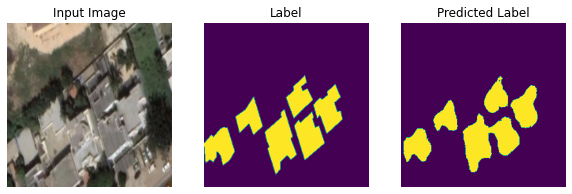


Sample Prediction after epoch 17

45/45 [==============================] - 1s 23ms/step - loss: 0.1100 - dice_coef: 0.8919 - accuracy: 0.9305 - val_loss: 0.5470 - val_dice_coef: 0.5591 - val_accuracy: 0.8014
Epoch 18/45
40/45 [=========================>....] - ETA: 0s - loss: 0.1027 - dice_coef: 0.9005 - accuracy: 0.9345

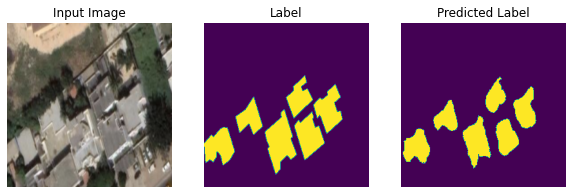


Sample Prediction after epoch 18

45/45 [==============================] - 1s 24ms/step - loss: 0.1043 - dice_coef: 0.8965 - accuracy: 0.9332 - val_loss: 0.5698 - val_dice_coef: 0.5381 - val_accuracy: 0.8112
Epoch 19/45
43/45 [===========================>..] - ETA: 0s - loss: 0.1144 - dice_coef: 0.8942 - accuracy: 0.9287

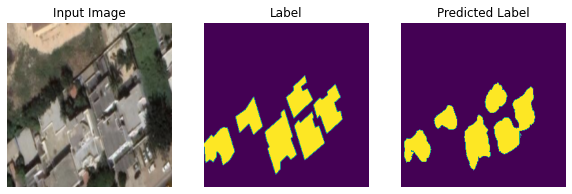


Sample Prediction after epoch 19

45/45 [==============================] - 1s 25ms/step - loss: 0.1126 - dice_coef: 0.8933 - accuracy: 0.9297 - val_loss: 0.5674 - val_dice_coef: 0.5459 - val_accuracy: 0.8125
Epoch 20/45
44/45 [============================>.] - ETA: 0s - loss: 0.1068 - dice_coef: 0.8957 - accuracy: 0.9320

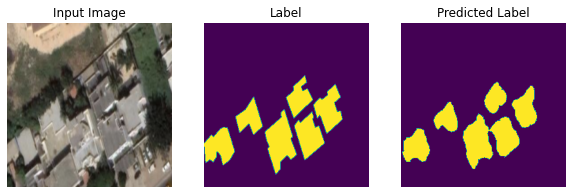


Sample Prediction after epoch 20

45/45 [==============================] - 1s 27ms/step - loss: 0.1055 - dice_coef: 0.8961 - accuracy: 0.9328 - val_loss: 0.5430 - val_dice_coef: 0.5627 - val_accuracy: 0.8141
Epoch 21/45
44/45 [============================>.] - ETA: 0s - loss: 0.0988 - dice_coef: 0.9018 - accuracy: 0.9348

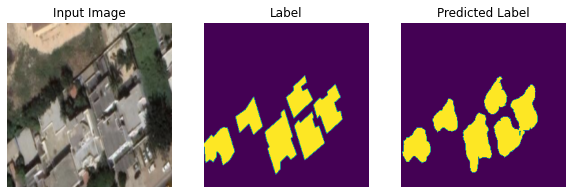


Sample Prediction after epoch 21

45/45 [==============================] - 1s 30ms/step - loss: 0.0983 - dice_coef: 0.9026 - accuracy: 0.9351 - val_loss: 0.5528 - val_dice_coef: 0.5717 - val_accuracy: 0.8096
Epoch 22/45
42/45 [===========================>..] - ETA: 0s - loss: 0.0958 - dice_coef: 0.9048 - accuracy: 0.9361

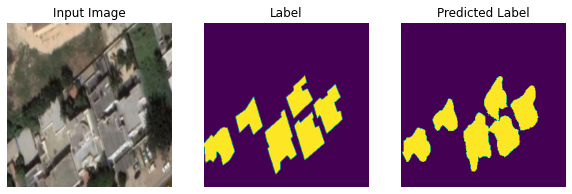


Sample Prediction after epoch 22

45/45 [==============================] - 1s 26ms/step - loss: 0.0955 - dice_coef: 0.9032 - accuracy: 0.9362 - val_loss: 0.5806 - val_dice_coef: 0.5671 - val_accuracy: 0.8137
Epoch 23/45
44/45 [============================>.] - ETA: 0s - loss: 0.0987 - dice_coef: 0.9066 - accuracy: 0.9356

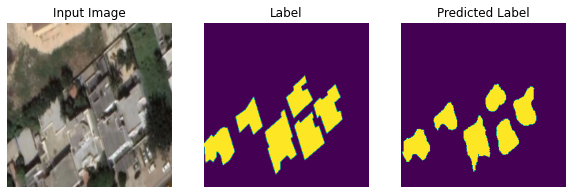


Sample Prediction after epoch 23

45/45 [==============================] - 1s 30ms/step - loss: 0.0988 - dice_coef: 0.9049 - accuracy: 0.9353 - val_loss: 0.6429 - val_dice_coef: 0.5189 - val_accuracy: 0.8103
Epoch 24/45
43/45 [===========================>..] - ETA: 0s - loss: 0.1041 - dice_coef: 0.8972 - accuracy: 0.9332

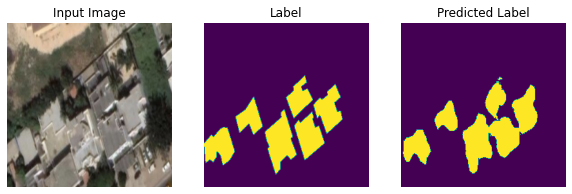


Sample Prediction after epoch 24

45/45 [==============================] - 1s 25ms/step - loss: 0.1043 - dice_coef: 0.8990 - accuracy: 0.9332 - val_loss: 0.6260 - val_dice_coef: 0.5436 - val_accuracy: 0.8136
Epoch 25/45
40/45 [=========================>....] - ETA: 0s - loss: 0.1194 - dice_coef: 0.8816 - accuracy: 0.9270

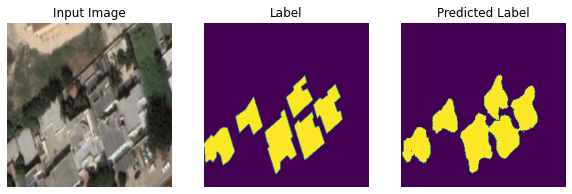


Sample Prediction after epoch 25

45/45 [==============================] - 1s 25ms/step - loss: 0.1188 - dice_coef: 0.8837 - accuracy: 0.9269 - val_loss: 0.5511 - val_dice_coef: 0.5723 - val_accuracy: 0.8016
Epoch 26/45
40/45 [=========================>....] - ETA: 0s - loss: 0.1198 - dice_coef: 0.8898 - accuracy: 0.9270

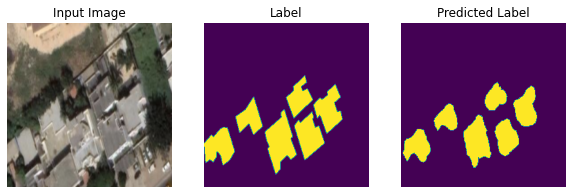


Sample Prediction after epoch 26

45/45 [==============================] - 1s 25ms/step - loss: 0.1171 - dice_coef: 0.8864 - accuracy: 0.9277 - val_loss: 0.6115 - val_dice_coef: 0.5294 - val_accuracy: 0.8078
Epoch 27/45
42/45 [===========================>..] - ETA: 0s - loss: 0.1021 - dice_coef: 0.9007 - accuracy: 0.9337

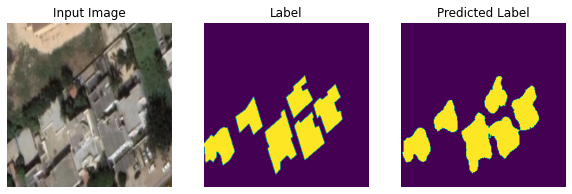


Sample Prediction after epoch 27

45/45 [==============================] - 1s 24ms/step - loss: 0.1027 - dice_coef: 0.8998 - accuracy: 0.9334 - val_loss: 0.5643 - val_dice_coef: 0.5613 - val_accuracy: 0.8089
Epoch 28/45
42/45 [===========================>..] - ETA: 0s - loss: 0.0950 - dice_coef: 0.9046 - accuracy: 0.9366

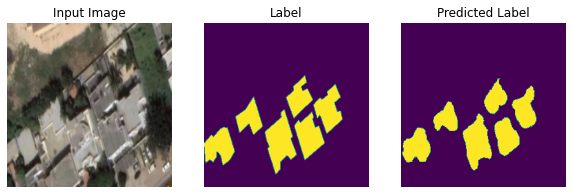


Sample Prediction after epoch 28

45/45 [==============================] - 1s 24ms/step - loss: 0.0942 - dice_coef: 0.9048 - accuracy: 0.9367 - val_loss: 0.5752 - val_dice_coef: 0.5607 - val_accuracy: 0.8159
Epoch 29/45
40/45 [=========================>....] - ETA: 0s - loss: 0.0917 - dice_coef: 0.9077 - accuracy: 0.9377

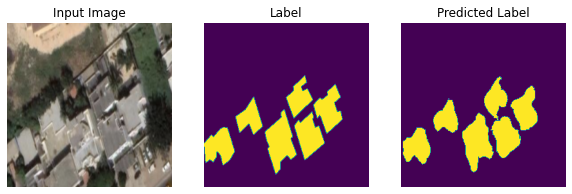


Sample Prediction after epoch 29

45/45 [==============================] - 1s 24ms/step - loss: 0.0919 - dice_coef: 0.9070 - accuracy: 0.9376 - val_loss: 0.5536 - val_dice_coef: 0.5877 - val_accuracy: 0.8100
Epoch 30/45
42/45 [===========================>..] - ETA: 0s - loss: 0.1019 - dice_coef: 0.9002 - accuracy: 0.9340

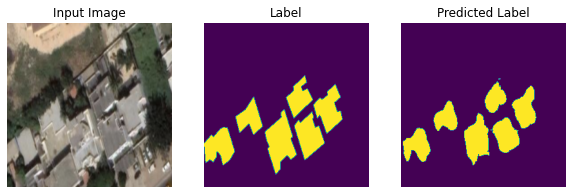


Sample Prediction after epoch 30

45/45 [==============================] - 1s 24ms/step - loss: 0.1018 - dice_coef: 0.8984 - accuracy: 0.9337 - val_loss: 0.6160 - val_dice_coef: 0.5460 - val_accuracy: 0.8135
Epoch 31/45
39/45 [=========================>....] - ETA: 0s - loss: 0.0983 - dice_coef: 0.9033 - accuracy: 0.9352

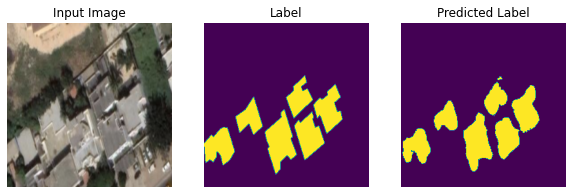


Sample Prediction after epoch 31

45/45 [==============================] - 1s 24ms/step - loss: 0.0985 - dice_coef: 0.9017 - accuracy: 0.9349 - val_loss: 0.5950 - val_dice_coef: 0.5485 - val_accuracy: 0.8054
Epoch 32/45
41/45 [==========================>...] - ETA: 0s - loss: 0.0951 - dice_coef: 0.9055 - accuracy: 0.9370

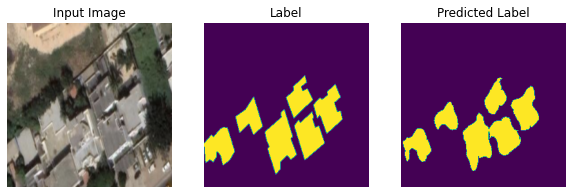


Sample Prediction after epoch 32

45/45 [==============================] - 1s 24ms/step - loss: 0.0946 - dice_coef: 0.9059 - accuracy: 0.9370 - val_loss: 0.6319 - val_dice_coef: 0.5581 - val_accuracy: 0.8132
Epoch 33/45
41/45 [==========================>...] - ETA: 0s - loss: 0.0922 - dice_coef: 0.9098 - accuracy: 0.9374

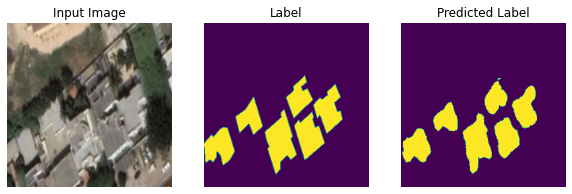


Sample Prediction after epoch 33

45/45 [==============================] - 1s 24ms/step - loss: 0.0929 - dice_coef: 0.9076 - accuracy: 0.9370 - val_loss: 0.5822 - val_dice_coef: 0.5681 - val_accuracy: 0.8142
Epoch 34/45
44/45 [============================>.] - ETA: 0s - loss: 0.0921 - dice_coef: 0.9066 - accuracy: 0.9373

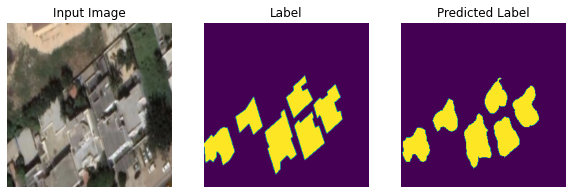


Sample Prediction after epoch 34

45/45 [==============================] - 1s 24ms/step - loss: 0.0922 - dice_coef: 0.9073 - accuracy: 0.9372 - val_loss: 0.5793 - val_dice_coef: 0.5703 - val_accuracy: 0.8136
Epoch 35/45
41/45 [==========================>...] - ETA: 0s - loss: 0.0904 - dice_coef: 0.9107 - accuracy: 0.9381

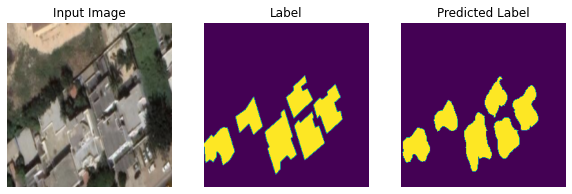


Sample Prediction after epoch 35

45/45 [==============================] - 1s 28ms/step - loss: 0.0901 - dice_coef: 0.9100 - accuracy: 0.9384 - val_loss: 0.6028 - val_dice_coef: 0.5615 - val_accuracy: 0.8109
Epoch 36/45
43/45 [===========================>..] - ETA: 0s - loss: 0.0893 - dice_coef: 0.9099 - accuracy: 0.9379

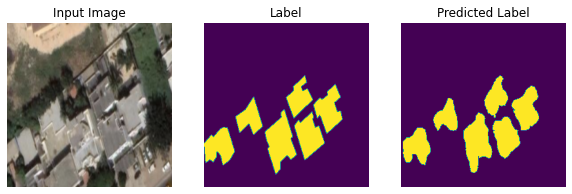


Sample Prediction after epoch 36

45/45 [==============================] - 1s 27ms/step - loss: 0.0882 - dice_coef: 0.9093 - accuracy: 0.9386 - val_loss: 0.6246 - val_dice_coef: 0.5677 - val_accuracy: 0.8025
Epoch 37/45
40/45 [=========================>....] - ETA: 0s - loss: 0.0952 - dice_coef: 0.9054 - accuracy: 0.9361

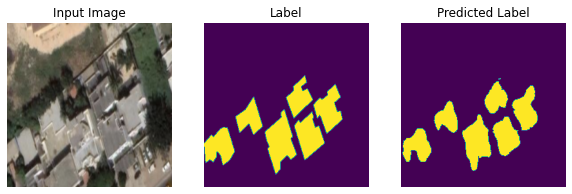


Sample Prediction after epoch 37

45/45 [==============================] - 1s 27ms/step - loss: 0.0937 - dice_coef: 0.9064 - accuracy: 0.9368 - val_loss: 0.6296 - val_dice_coef: 0.5541 - val_accuracy: 0.8033
Epoch 38/45
42/45 [===========================>..] - ETA: 0s - loss: 0.0933 - dice_coef: 0.9076 - accuracy: 0.9367

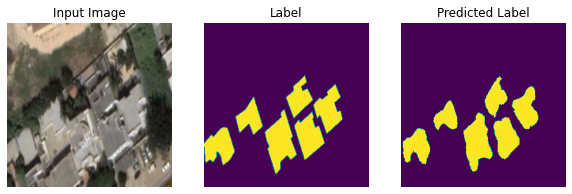


Sample Prediction after epoch 38

45/45 [==============================] - 1s 28ms/step - loss: 0.0923 - dice_coef: 0.9080 - accuracy: 0.9374 - val_loss: 0.6083 - val_dice_coef: 0.5522 - val_accuracy: 0.8096
Epoch 39/45
41/45 [==========================>...] - ETA: 0s - loss: 0.0925 - dice_coef: 0.9078 - accuracy: 0.9370

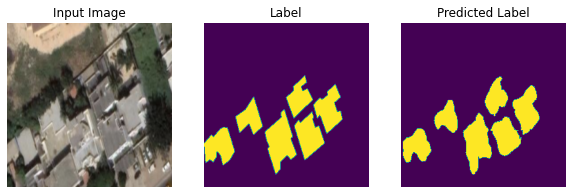


Sample Prediction after epoch 39

45/45 [==============================] - 1s 31ms/step - loss: 0.0911 - dice_coef: 0.9084 - accuracy: 0.9378 - val_loss: 0.6150 - val_dice_coef: 0.5742 - val_accuracy: 0.7982
Epoch 40/45
42/45 [===========================>..] - ETA: 0s - loss: 0.0928 - dice_coef: 0.9045 - accuracy: 0.9378

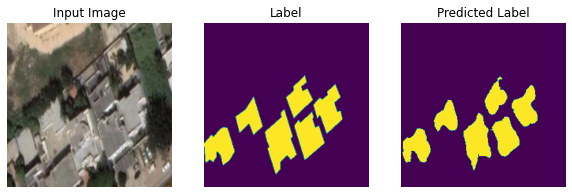


Sample Prediction after epoch 40

45/45 [==============================] - 1s 24ms/step - loss: 0.0950 - dice_coef: 0.9045 - accuracy: 0.9360 - val_loss: 0.6034 - val_dice_coef: 0.5661 - val_accuracy: 0.8077
Epoch 41/45
40/45 [=========================>....] - ETA: 0s - loss: 0.0966 - dice_coef: 0.9039 - accuracy: 0.9361

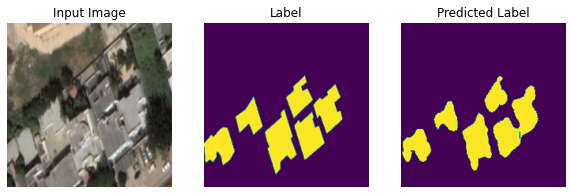


Sample Prediction after epoch 41

45/45 [==============================] - 1s 25ms/step - loss: 0.0975 - dice_coef: 0.9034 - accuracy: 0.9354 - val_loss: 0.7007 - val_dice_coef: 0.5542 - val_accuracy: 0.8099
Epoch 42/45
41/45 [==========================>...] - ETA: 0s - loss: 0.0980 - dice_coef: 0.9060 - accuracy: 0.9352

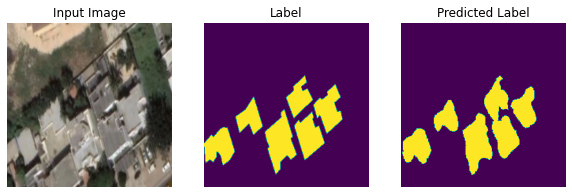


Sample Prediction after epoch 42

45/45 [==============================] - 1s 25ms/step - loss: 0.0967 - dice_coef: 0.9052 - accuracy: 0.9360 - val_loss: 0.5898 - val_dice_coef: 0.5707 - val_accuracy: 0.8046
Epoch 43/45
41/45 [==========================>...] - ETA: 0s - loss: 0.0947 - dice_coef: 0.9039 - accuracy: 0.9361

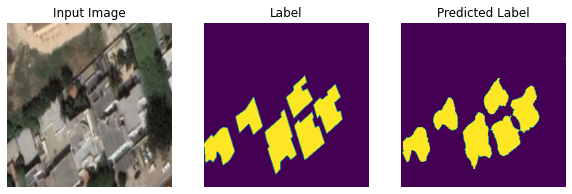


Sample Prediction after epoch 43

45/45 [==============================] - 1s 25ms/step - loss: 0.0937 - dice_coef: 0.9055 - accuracy: 0.9368 - val_loss: 0.6185 - val_dice_coef: 0.5715 - val_accuracy: 0.7984
Epoch 44/45
41/45 [==========================>...] - ETA: 0s - loss: 0.0926 - dice_coef: 0.9083 - accuracy: 0.9368

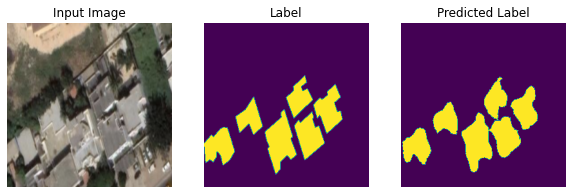


Sample Prediction after epoch 44

45/45 [==============================] - 1s 26ms/step - loss: 0.0918 - dice_coef: 0.9066 - accuracy: 0.9374 - val_loss: 0.5927 - val_dice_coef: 0.5792 - val_accuracy: 0.8054
Epoch 45/45
43/45 [===========================>..] - ETA: 0s - loss: 0.0864 - dice_coef: 0.9131 - accuracy: 0.9398

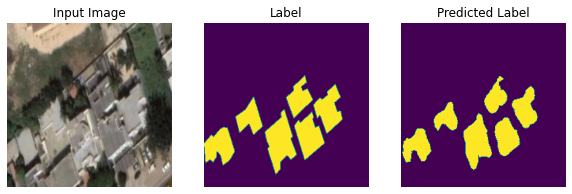


Sample Prediction after epoch 45

45/45 [==============================] - 1s 25ms/step - loss: 0.0860 - dice_coef: 0.9126 - accuracy: 0.9399 - val_loss: 0.6363 - val_dice_coef: 0.5578 - val_accuracy: 0.8126


In [76]:
EPOCHS = 45
model_history_cnn_dice = model_cnn_dice.fit(train_dataset_cnn, 
                                              epochs=EPOCHS,
                                              steps_per_epoch=STEPS_PER_EPOCH,
                                              validation_steps=VALIDATION_STEPS,
                                              validation_data=test_dataset_cnn,
                                              callbacks=[displayCallback_cnn, tensorboard_callback_cnn])

In [77]:
# Evaluate
model_cnn_dice.evaluate(test_dataset_cnn)

5/5 [==============================] - 0s 9ms/step - loss: 0.6363 - dice_coef: 0.5578 - accuracy: 0.8126


[0.6362937092781067, 0.5578432083129883, 0.8126495480537415]

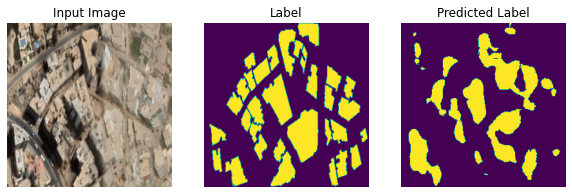

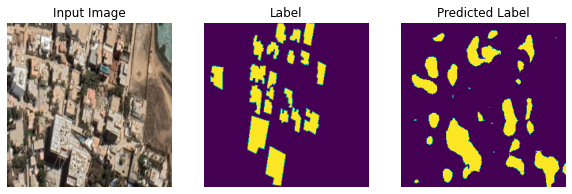

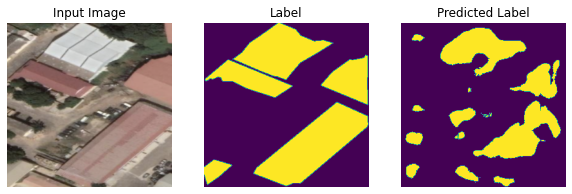

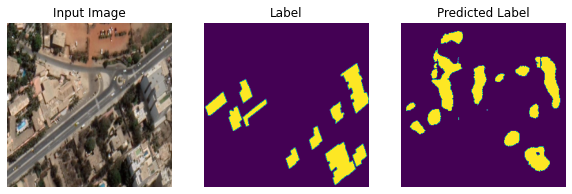

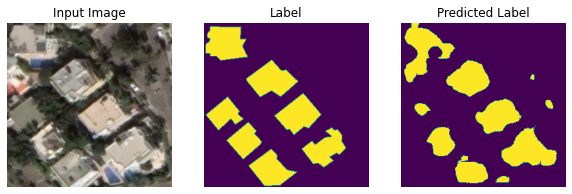

In [78]:
# make some predictions
show_predictions(model = model_cnn_dice, 
                 img_size =256, 
                 dataset=test_dataset_cnn, 
                 num=5
                 )